# XAI for Twitter Hate Speech

## Dataset


In [ ]:
#Connect to google drive
#Run this for AVINASH
import pandas as pd
from google.colab import drive
drive.mount('/content/drive')
df = pd.read_csv('/content/drive/MyDrive/GRA/HateSpeech/hate-speech-tweets/train.csv', index_col=0)

In [2]:
#get file from drive folder
#run this for ICANN LAB USER 2
import pandas as pd
df = pd.read_csv('/content/train.csv', index_col=0)

In [3]:
df.tail()

,label,tweet
id,,
31958,0,ate @user isz that youuu?ðððððð...
31959,0,to see nina turner on the airwaves trying to...
31960,0,listening to sad songs on a monday morning otw...
31961,1,"@user #sikh #temple vandalised in in #calgary,..."
31962,0,thank you @user for you follow


In [4]:
df.head()

,label,tweet
id,,
1,0,@user when a father is dysfunctional and is s...
2,0,@user @user thanks for #lyft credit i can't us...
3,0,bihday your majesty
4,0,#model i love u take with u all the time in ...
5,0,factsguide: society now #motivation


In [ ]:
#get test dataset as well
# test_df = pd.read_csv('/content/drive/MyDrive/GRA/HateSpeech/hate-speech-tweets/test.csv', index_col=0)

In [5]:
#split my training data set into 80:20 split since test dataset does not have any labels
from sklearn.model_selection import train_test_split

train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

In [6]:
train_df

,label,tweet
id,,
12111,1,@user @user @user because i've been paying att...
14082,0,@user raft building at salford quays as pa of...
1830,0,friday ð ð» #gdegblog #friday #selfie #b...
2770,0,#fashion it is a true #fact
31819,0,"so to #share the #simple, #elegant #business..."
...,...,...
29803,0,#waltdisneyreso should be ashamed of themselv...
5391,0,@user invited @user over for a catch up and i...
861,1,black professor makes assumptions about an ent...


## Text Preprocessing

In [7]:
def preprocess_text(text):
  text = text.replace("&amp;", "&") #replaces &amp; with &
  text = text.replace("#", "") #removes hash symbols
  try: #encodes in latin1 and then decodes the string to present the emojis to the end user
    text = text.encode('latin1').decode('utf-8')
  except (UnicodeDecodeError, UnicodeEncodeError):
    return text

  return text

In [8]:
train_df['tweet'] = train_df['tweet'].apply(preprocess_text)
test_df['tweet'] = test_df['tweet'].apply(preprocess_text)

In [9]:
df['emoji_tweets'] = df['tweet'].apply(preprocess_text)

In [10]:
import matplotlib.pyplot as plt

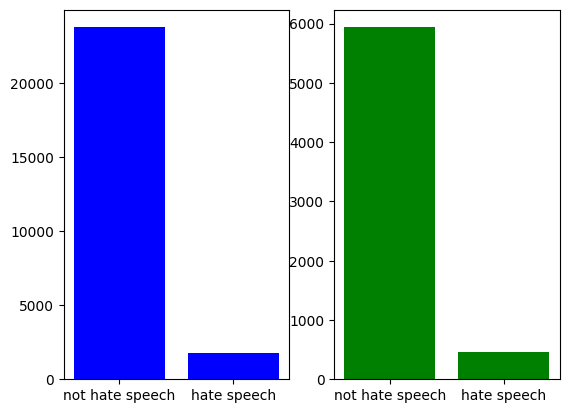

In [11]:
labels_train = train_df['label']
labels_test = test_df['label']

hate_labels_train = sum(labels_train)
not_hate_labels_train = len(labels_train) - sum(labels_train)

hate_labels_test = sum(labels_test)
not_hate_labels_test = len(labels_test) - sum(labels_test)


fig, (ax1,ax2) = plt.subplots(1,2)

_ = ax1.bar(x=["not hate speech", "hate speech"],
            height=[not_hate_labels_train, hate_labels_train],
            color='b')
_ = ax2.bar(x=["not hate speech", "hate speech"],
            height=[not_hate_labels_test, hate_labels_test],
            color='g')

##1. Role of Emojis in Predicting Labels
Emojis can play a significant role in understanding the context and sentiment of social media texts like tweets. They often convey emotions, sarcasm, or intensify the message, which could be crucial for accurately classifying a tweet as hate speech or not. Including emojis in your analysis might improve your model's performance by capturing these nuanced meanings that might not be evident from the text alone. However, the impact of emojis on prediction accuracy would ultimately depend on how your model processes them and the nature of your dataset.

##2. Preprocessing for Machine Learning and Deep Learning Models
Preprocessing text data for TF-IDF vectorization (for use with models like XGBoost) and for BERT classification involves different steps, given the distinct nature of these models. Here's a general approach for both:

###Preprocessing for TF-IDF Vectorization with XGBoost:
Text Normalization: Convert the text to lowercase to ensure uniformity.
Handling Emojis: Translate emojis to text using libraries like emoji or demoji to capture their sentiment and meaning.
Removing Noise: Strip out unnecessary characters, such as URLs, usernames, or special characters that might not be relevant.
Tokenization: Split the text into individual words or tokens.
Stop Words Removal: Optionally, remove common words that add little value to the model.
Stemming/Lemmatization: Reduce words to their base or root form (though this step is optional and might not always be beneficial for TF-IDF).
After preprocessing, you can apply TF-IDF vectorization to convert the text data into a numerical format that machine learning models can work with.

###Preprocessing for BERT Classification:
BERT and similar transformer models are pre-trained on a vast corpus that includes punctuation, common words, and sometimes emojis. Therefore, the preprocessing steps are minimal:

Text Normalization: It might still be useful to convert text to lowercase, depending on your BERT model variant (cased vs. uncased).
Handling Emojis: Since BERT can handle a wide range of tokens, you might choose to leave emojis as they are, especially if using a model variant trained on social media text or one that can interpret emojis.
Special Tokens: Add special tokens required by BERT, such as [CLS] at the beginning and [SEP] at the end of your texts.
Visualization and Explanation with LIME/SHAP and transformers-interpret
For TF-IDF with XGBoost: LIME and SHAP are powerful tools for explaining predictions. LIME can be used to create interpretable models that approximate your XGBoost model's behavior, while SHAP values can provide insights into the contribution of each feature (word or emoji) to the prediction.

For BERT Classification: The transformers-interpret library allows you to explain predictions made by transformer models like BERT. It computes attributions for each token's contribution to the model's output, helping you understand why the model made a certain prediction.

In both cases, preprocessing plays a crucial role in ensuring that the text data is in the appropriate format for the model and the explanation tool to work effectively. For visualization, ensure that your preprocessing steps retain the original structure and meaning of the text as much as possible, especially when working with tools like LIME/SHAP and transformers-interpret, as the explanations provided will be directly related to the input features (words, tokens) used by the model.






# BERT base uncased PyTorch

## Training the Model

In [ ]:
!pip install transformers

import torch
import torch.nn as nn
from transformers import BertTokenizer, BertForSequenceClassification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [ ]:
# loading pretrained bert model
model_name = 'bert-base-uncased'
tokenizer = BertTokenizer.from_pretrained(model_name)
model = BertForSequenceClassification.from_pretrained(model_name, num_labels=2)  # 2 classes: not_hate(0) AND hate(1)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12,

In [ ]:
texts = df['emoji_tweets'].tolist()
sentiments = df['label'].tolist()

In [ ]:
print(df['emoji_tweets'])

id
1         @user when a father is dysfunctional and is s...
2        @user @user thanks for lyft credit i can't use...
3                                      bihday your majesty
4        model   i love u take with u all the time in u...
5                    factsguide: society now    motivation
                               ...                        
31958                ate @user isz that youuu?😍😍😍😍😍😍😍😍😍❤️ 
31959      to see nina turner on the airwaves trying to...
31960    listening to sad songs on a monday morning otw...
31961    @user sikh temple vandalised in in calgary, ws...
31962                     thank you @user for you follow  
Name: emoji_tweets, Length: 31962, dtype: object


In [ ]:
train_texts, val_texts, train_labels, val_labels = train_test_split(texts, sentiments, test_size=0.2, random_state=42)

In [ ]:
batch_size = 32
num_epochs = 3
optimizer = torch.optim.AdamW(model.parameters(), lr=2e-5)

In [ ]:
def get_data_loader(texts, labels, batch_size):
    encoded_texts = tokenizer.batch_encode_plus(texts, padding=True, truncation=True, return_tensors="pt")
    input_ids = encoded_texts["input_ids"]
    attention_mask = encoded_texts["attention_mask"]
    labels = torch.tensor(labels)
    dataset = torch.utils.data.TensorDataset(input_ids, attention_mask, labels)
    return torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

train_loader = get_data_loader(train_texts, train_labels, batch_size)
val_loader = get_data_loader(val_texts, val_labels, batch_size)

In [ ]:
criterion = nn.CrossEntropyLoss()

for epoch in range(num_epochs):
    model.train()
    train_loss = 0.0
    train_acc = 0.0

    for batch in train_loader:
        input_ids, attention_mask, labels = batch
        input_ids, attention_mask, labels = input_ids.to(device), attention_mask.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        predicted_labels = torch.argmax(outputs.logits, dim=1)
        train_acc += accuracy_score(labels.cpu().numpy(), predicted_labels.cpu().numpy())

    train_loss /= len(train_loader)
    train_acc /= len(train_loader)

    # Validation
    model.eval()
    val_loss = 0.0
    val_acc = 0.0

    with torch.no_grad():
        for batch in val_loader:
            input_ids, attention_mask, labels = batch
            input_ids, attention_mask, labels = input_ids.to(device), attention_mask.to(device), labels.to(device)

            outputs = model(input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss

            val_loss += loss.item()
            predicted_labels = torch.argmax(outputs.logits, dim=1)
            val_acc += accuracy_score(labels.cpu().numpy(), predicted_labels.cpu().numpy())

        val_loss /= len(val_loader)
        val_acc /= len(val_loader)

    print(f"Epoch {epoch+1}/{num_epochs} - Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.4f}")


Epoch 1/3 - Train Loss: 0.1289, Train Acc: 0.9560, Val Loss: 0.0930, Val Acc: 0.9648
Epoch 2/3 - Train Loss: 0.0563, Train Acc: 0.9800, Val Loss: 0.1314, Val Acc: 0.9606
Epoch 3/3 - Train Loss: 0.0211, Train Acc: 0.9934, Val Loss: 0.1044, Val Acc: 0.9718


In [ ]:
torch.save(model.state_dict(), 'trained_model.pth')

## Trained Model Evaluation

In [ ]:
import torch
import pandas as pd
from transformers import BertTokenizer, BertForSequenceClassification

# Load the trained model
model_name = 'bert-base-uncased'
model = BertForSequenceClassification.from_pretrained(model_name, num_labels=2)
model.load_state_dict(torch.load('/content/trained_model.pth'))  # Load the trained weights
model.eval()  # Set the model to evaluation mode

# Load the tokenizer
tokenizer = BertTokenizer.from_pretrained(model_name)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification

# Input texts
texts = ["michelleobama is the most hated women in america today! get your facts straight @user ! her and her oprah",
         "i despise this #antiamerican #muslimpos @user & everything he stands for! trying to destroy the usa…"]

# Tokenize the texts
inputs = tokenizer(texts, padding=True, truncation=True, return_tensors="pt")

# Predict
with torch.no_grad():  # Disable gradient calculation for inference
    outputs = model(**inputs)
    predictions = torch.softmax(outputs.logits, dim=1)  # Get probabilities

# Extract and print the predictions along with probabilities
for i, text in enumerate(texts):
    probs = predictions[i].tolist()  # Convert tensor to list for easier handling
    predicted_class = probs.index(max(probs))
    print(f"Text {i}: {text}\nPredicted Class: {'Hate Speech' if predicted_class else 'Not Hate Speech'}\nProbabilities: {probs}\n")

# For calculating precision, accuracy, and recall, you would typically do something like this:
from sklearn.metrics import precision_score, accuracy_score, recall_score
true_labels = [1,1]  # Your true labels here
predicted_labels = [probs.index(max(probs)) for probs in predictions.tolist()]
precision = precision_score(true_labels, predicted_labels)
accuracy = accuracy_score(true_labels, predicted_labels)
recall = recall_score(true_labels, predicted_labels)
print(f"Precision: {precision*100:.2f}%, Accuracy: {accuracy*100:.2f}%, Recall: {recall*100:.2f}%")


Text 0: michelleobama is the most hated women in america today! get your facts straight @user ! her and her oprah
Predicted Class: Not Hate Speech
Probabilities: [0.8266258239746094, 0.17337416112422943]

Text 1: i despise this #antiamerican #muslimpos @user & everything he stands for! trying to destroy the usa…
Predicted Class: Hate Speech
Probabilities: [0.010363074950873852, 0.9896369576454163]

Precision: 100.00%, Accuracy: 50.00%, Recall: 50.00%


In [ ]:
#Confidence calculation
# Calculate and print the confidence for each prediction
for i, text in enumerate(texts):
    probs = predictions[i].tolist()  # Convert tensor to list for easier handling
    predicted_class = probs.index(max(probs))
    confidence = max(probs)  # Confidence is the max probability
    print(f"Text {i}: {text}\nPredicted Class: {'Hate Speech' if predicted_class else 'Not Hate Speech'}, Confidence: {confidence*100:.2f}%\n")


Text 0: michelleobama is the most hated women in america today! get your facts straight @user ! her and her oprah
Predicted Class: Not Hate Speech, Confidence: 82.66%

Text 1: i despise this #antiamerican #muslimpos @user & everything he stands for! trying to destroy the usa…
Predicted Class: Hate Speech, Confidence: 98.96%



# BERT Base Uncased Tensorflow

In [1]:
%tensorflow_version 2.x
!pip install textualheatmap transformers

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 7.4 MB/s eta 0:00:00
  Created wheel for textualheatmap: filename=textualheatmap-1.1.1-py3-none-any.whl size=8765 sha256=770bbe27d3885e21127cdebfed8b0678b3a366ae344b06983a0461083b04f3aa
  Stored in directory: /root/.cache/pip/wheels/f9/b6/01/ef7f5d0952f9daa7c8d61e8a0579844c068957ce2335b828c0
Successfully built textualheatmap


In [13]:
texts = df['emoji_tweets'].tolist()
sentiments = df['label'].tolist()

In [14]:
train_texts, val_texts, train_labels, val_labels = train_test_split(texts, sentiments, test_size=0.2, random_state=42)

In [15]:
from transformers import BertTokenizer

# Load the BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

# Tokenize the texts
train_encodings = tokenizer(list(train_texts), truncation=True, padding=True, max_length=128)
val_encodings = tokenizer(list(val_texts), truncation=True, padding=True, max_length=128)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

In [16]:
import tensorflow as tf

# Convert to TensorFlow datasets
train_dataset = tf.data.Dataset.from_tensor_slices((
    dict(train_encodings),
    train_labels
))
val_dataset = tf.data.Dataset.from_tensor_slices((
    dict(val_encodings),
    val_labels
))

# Prepare datasets for training
train_dataset = train_dataset.shuffle(len(train_texts)).batch(8)
val_dataset = val_dataset.batch(8)


In [21]:
import tensorflow as tf
from transformers import TFBertForSequenceClassification

# Load the pre-trained BERT model
model = TFBertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=2)
# Compile the model with a built-in loss function
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

# Fine-tune the model
model.fit(train_dataset, validation_data=val_dataset, epochs=3)

All PyTorch model weights were used when initializing TFBertForSequenceClassification.

Some weights or buffers of the TF 2.0 model TFBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch 1/3
3197/3197 [==============================] - 610s 171ms/step - loss: 0.2846 - accuracy: 0.9298 - val_loss: 0.2890 - val_accuracy: 0.9287
Epoch 2/3
3197/3197 [==============================] - 535s 167ms/step - loss: 0.2897 - accuracy: 0.9291 - val_loss: 0.2958 - val_accuracy: 0.9287
Epoch 3/3
3197/3197 [==============================] - 535s 167ms/step - loss: 0.2855 - accuracy: 0.9296 - val_loss: 0.3009 - val_accuracy: 0.9287


In [22]:
model.evaluate(val_dataset)

800/800 [==============================] - 60s 75ms/step - loss: 0.3009 - accuracy: 0.9287


[0.3008894920349121, 0.9286719560623169]

In [31]:
pip install transformers==3.1.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 884.0/884.0 kB 12.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 97.4/97.4 kB 14.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 897.5/897.5 kB 69.9 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × Building wheel for tokenizers (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for tokenizers
Failed to build tokenizers
ERROR: Could not build wheels for tokenizers, which is required to install pyproject.toml-based projects


In [74]:
print(model)

In [75]:
from transformers import TFBertForMaskedLM, BertTokenizer
bert_model = TFBertForMaskedLM.from_pretrained('bert-base-uncased')

All PyTorch model weights were used when initializing TFBertForMaskedLM.

All the weights of TFBertForMaskedLM were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertForMaskedLM for predictions without further training.


In [76]:
print(bert_model)

In [103]:
import numpy as np
import tensorflow as tf

def compute_textual_saliency(model, embedding_matrix, tokenizer, text):
    token_ids = tokenizer.encode(text, add_special_tokens=True)
    vocab_size = embedding_matrix.get_shape()[0]

    heatmap_data = []

    for masked_token_index in range(len(token_ids)):
        # print(f'processing token {masked_token_index + 1} / {len(token_ids)}')

        if masked_token_index == 0:
            heatmap_data.append({
                'token': '[CLR]',
                'meta': ['', '', ''],
                'heat': [1] + [0] * (len(token_ids) - 1)
            })
        elif masked_token_index == len(token_ids) - 1:
            heatmap_data.append({
                'token': ' ',
                'format': True
            })
            heatmap_data.append({
                'token': '[SEP]',
                'meta': ['', '', ''],
                'heat': [0] * (len(token_ids) - 1) + [1]
            })
        else:
            # Get the actual token
            target_token = tokenizer.convert_ids_to_tokens(
                token_ids[masked_token_index])

            if target_token[0:2] == '##':
                target_token = target_token[2:]
            else:
                heatmap_data.append({
                    'token': ' ',
                    'format': True
                })

            # integers are not differentable, so use a one-hot encoding
            # of the intput
            token_ids_tensor = tf.constant([
                token_ids[0:masked_token_index] +
                [tokenizer.mask_token_id] +
                token_ids[masked_token_index + 1:]
            ], dtype='int32')
            token_ids_tensor_one_hot = tf.one_hot(token_ids_tensor, vocab_size)

            # To select, the correct output witch is what the importance
            # measure targets, create a masking tensor. tf.gather_nd could also
            # be used, but this is easier.
            output_mask = np.zeros((1, len(token_ids), vocab_size))
            output_mask[0, masked_token_index, token_ids[masked_token_index]] = 1
            output_mask_tensor = tf.constant(output_mask, dtype='float32')

            # Compute gradient of the logits of the correct target, w.r.t. the
            # input
            with tf.GradientTape(watch_accessed_variables=False) as tape:
                tape.watch(token_ids_tensor_one_hot)
                inputs_embeds = tf.matmul(token_ids_tensor_one_hot,embedding_matrix)
                predict_output = model({"inputs_embeds": inputs_embeds})
                predict = predict_output.logits
                predict_mask_correct_token = tf.reduce_sum(predict * output_mask_tensor)

            # Get the top-3 predictions
            (_, top_3_indices) = tf.math.top_k(predict[0, masked_token_index, :], 3)
            top_3_predicted_tokens = tokenizer.convert_ids_to_tokens(top_3_indices)

            # compute the connectivity
            connectivity_non_normalized = tf.norm(
                tape.gradient(predict_mask_correct_token, token_ids_tensor_one_hot),
                axis=2)
            connectivity_tensor = (
                connectivity_non_normalized /
                tf.reduce_max(connectivity_non_normalized)
            )
            connectivity = connectivity_tensor[0].numpy().tolist()

            heatmap_data.append({
                'token': target_token,
                'meta': top_3_predicted_tokens,
                'heat': connectivity
            })

    return heatmap_data

In [104]:
text = ("context the formal study of grammar is an important part of education"
        " from a young age through advanced learning though the rules taught"
        " in schools are not a grammar in the sense most linguists use")


from transformers import TFBertForMaskedLM, BertTokenizer
# bert_model = TFBertForMaskedLM.from_pretrained('bert-base-uncased')
bert_tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
bert_model = TFBertForMaskedLM.from_pretrained('bert-base-uncased')
bert_embmat = bert_model.bert.embeddings.weight
from textualheatmap import TextualHeatmap
heatmap = TextualHeatmap(facet_titles = ['BERT'], show_meta=True)
heatmap.set_data([
    compute_textual_saliency(bert_model, bert_embmat, bert_tokenizer, text)
])

All PyTorch model weights were used when initializing TFBertForMaskedLM.

All the weights of TFBertForMaskedLM were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertForMaskedLM for predictions without further training.


<IPython.core.display.Javascript object>

# Explanations

## Transformers Interpret

In [ ]:
!pip install transformers-interpret

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.8/45.8 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 36.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 82.4 MB/s eta 0:00:00


In [ ]:
# First, make sure you have transformers-interpret installed
# pip install transformers-interpret

from transformers import BertTokenizer, BertForSequenceClassification
from transformers_interpret import SequenceClassificationExplainer

texts = ["michelleobama is the most hated women in america today! get your facts straight @user ! her and her oprah",
         "i despise this antiamerican muslimpos @user & everything he stands for! trying to destroy the usa…"]


# Create a sequence classification explainer
explainer = SequenceClassificationExplainer(
    model=model,
    tokenizer=tokenizer
)

# Loop through texts to explain each one
for i, text in enumerate(texts):
    # Get the word attributions for the text
    word_attributions = explainer(text)

    # Print the word attributions
    print(f"Text: {text}\nAttributions:\n{word_attributions}\n")
    explainer.visualize().data


Text: michelleobama is the most hated women in america today! get your facts straight @user ! her and her oprah
Attributions:
[('[CLS]', 0.0), ('michelle', 0.2503907292602073), ('##ob', 0.13142627582226366), ('##ama', -0.17622741186978236), ('is', 0.18978811080955862), ('the', -0.1470544766911343), ('most', -0.23885320512054992), ('hated', -0.37568982291257136), ('women', -0.2042804781497913), ('in', 0.1511606731890906), ('america', 0.1945112991679528), ('today', 0.4565003111446372), ('!', 0.005279886885319761), ('get', -0.08014809953515681), ('your', -0.015086413542880943), ('facts', 0.02195904578140445), ('straight', -0.2420442287033396), ('@', -0.14893040004441907), ('user', -0.04188279061001319), ('!', 0.05008580460577913), ('her', -0.20253852932113137), ('and', -0.07070961402417415), ('her', 0.04577360802124114), ('op', 0.35407655526174087), ('##rah', -0.23801905798073345), ('[SEP]', 0.0)]



Text: i despise this antiamerican muslimpos @user & everything he stands for! trying to destroy the usa…
Attributions:
[('[CLS]', 0.0), ('i', 0.06306626909401335), ('des', -0.13566072929809186), ('##pis', -0.004978856055166109), ('##e', 0.023573509055875446), ('this', 0.3875649337969326), ('anti', 0.4664901004878172), ('##ame', 0.04620124488582489), ('##rica', 0.25950254861819294), ('##n', 0.2661200490374779), ('muslim', -0.13836132027687595), ('##po', 0.039534454848134455), ('##s', 0.06697762820236301), ('@', -0.08910138317598452), ('user', -0.020939341730858912), ('&', 0.34335930955491134), ('everything', -0.22852957206417251), ('he', 0.05615697450341851), ('stands', 0.009720552022953246), ('for', 0.0735748375599192), ('!', -0.4145653216472292), ('trying', 0.024955646608556478), ('to', 0.07300603964879536), ('destroy', -0.20185229608361877), ('the', 0.013737149409189657), ('usa', 0.012735475506090626), ('…', 0.19405492550484388), ('[SEP]', 0.0)]



## LIME

In [96]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 3.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=86d6d664b5eb341a18fa9634c598e6b95cb92fc4897052b9e8f974d5452d29b9
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification
from lime.lime_text import LimeTextExplainer
import numpy as np

# Define a prediction function that LIME can use
def predict_proba(texts):
    # Tokenize the input texts
    inputs = tokenizer(texts, padding=True, truncation=True, return_tensors="pt")
    # Predict
    with torch.no_grad():
        outputs = model(**inputs)
        predictions = torch.softmax(outputs.logits, dim=1).numpy()  # Convert to numpy array
    return predictions

# Create a LIME text explainer
explainer = LimeTextExplainer(class_names=['Not Hate Speech', 'Hate Speech'])

# Choose the text you want to explain
texts_to_explain = ["michelleobama is the most hated women in america today! get your facts straight @user ! her and her oprah",
                    "i despise this antiamerican muslimpos @user & everything he stands for! trying to destroy the usa…"]

for i, text in enumerate(texts_to_explain):
    # Generate explanation for the ith text
    exp = explainer.explain_instance(text, predict_proba, num_features=10, labels=[0, 1])

    print(f"Explanation for Text {i}:")
    exp.show_in_notebook(text=True)  # Use exp.as_pyplot_figure() if not in a notebook

Explanation for Text 0:


Explanation for Text 1:


## SHAP

In [ ]:
!pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 535.7/535.7 kB 9.7 MB/s eta 0:00:00


In [ ]:
import shap
import torch
import pandas as pd
from transformers import BertTokenizer, BertForSequenceClassification

# # Load the trained model
# model_name = 'bert-base-uncased'
# model = BertForSequenceClassification.from_pretrained(model_name, num_labels=3)
# model.load_state_dict(torch.load('/content/trained_model.pth'))  # Load the trained weights
# model.eval()  # Set the model to evaluation mode

# # Load the tokenizer
# tokenizer = BertTokenizer.from_pretrained(model_name)

# Define a prediction function for SHAP
def f(x):
    encoded_inputs = tokenizer.batch_encode_plus(x, padding=True, truncation=True, return_tensors="pt")
    input_ids = encoded_inputs["input_ids"]
    attention_mask = encoded_inputs["attention_mask"]
    with torch.no_grad():
        outputs = model(input_ids, attention_mask=attention_mask)[0]
        scores = torch.softmax(outputs, dim=1).detach().cpu().numpy()
    return scores

# Build the SHAP explainer
explainer = shap.Explainer(f, tokenizer)

# Example data with 3 sentiments
data = texts

# Explain the model's predictions using SHAP
shap_values = explainer(data[:2])

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|█████     | 1/2 [00:00<?, ?it/s]

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 3it [00:31, 15.75s/it]


In [ ]:
shap.plots.text(shap_values)

## GPT 4 Textual Explanations

### **Text**: "#michelleobama is the most hated women in america today! get your facts straight @user ! her and her #oprah"

**Prediction**: {0}

**Reasoning**: The tweet expresses a negative sentiment towards Michelle Obama and Oprah Winfrey by claiming they are widely disliked. However, it does not contain explicit hate speech, threats, or direct attacks based on race, religion, gender, or any other protected characteristic. The use of "the most hated women in America today" is hyperbolic and may reflect strong personal dislike rather than an intent to spread hate or incite harm. The directive to "get your facts straight" suggests a disagreement with another user's views or statements. Therefore, while the tweet is negative and critical, it does not meet the criteria for hate speech as it lacks the elements of incitement, discrimination, or derogation based on inherent characteristics.



### **Text**: "i despise this #antiamerican #muslimpos @user & everything he stands for! trying to destroy the usa…"

**Prediction**: {1}

**Reasoning**: This tweet exhibits clear indicators of hate speech. The use of "despise" along with "#antiamerican #muslimpos" (where "pos" likely stands for a derogatory term) directly targets an individual or group based on their perceived religious or national identity, which is a key characteristic of hate speech. The accusation of trying to destroy the USA further amplifies the negative sentiment by suggesting harmful intentions or actions attributed to the individual's religious or national identity. This content propagates hostility and animosity towards a specific group, thereby qualifying as hate speech due to its explicit derogatory and discriminatory language.

## Explanations for One Example

In [ ]:
test_df

,label,tweet
id,,
12228,0,@user “my mom says my smile is captivating… i...
14710,0,"in 3 days i will be meeting my sis-n-law, coun..."
19320,0,hating the conservative homophobes using this ...
4309,0,awee if this doesn't scream friday acewells...
24056,0,fathersday fatherâs day god! Â« tony a. sm...
...,...,...
2092,0,staing in monday 😃 c9 foreverliving foreverliv...
12407,1,newyear! new prez. new destruction. new commer...
3885,0,this arrived in the post this morning newboo...


In [ ]:
#LIME
import lime
from lime.lime_text import LimeTextExplainer
from transformers import BertTokenizer

# Assuming your model is a HuggingFace Transformers model
# and you've trained it on preprocessed text
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

def model_predict(texts):
    # Preprocess texts
    preprocessed_texts = texts

    # Tokenize texts
    inputs = tokenizer(preprocessed_texts, return_tensors='pt', padding=True, truncation=True, max_length=512)

    # Predict
    with torch.no_grad():
        logits = model(**inputs).logits
    probabilities = torch.softmax(logits, dim=1).numpy()
    return probabilities


# Create a LIME explainer
explainer = LimeTextExplainer(class_names=['Not Hate Speech', 'Hate Speech'])

# Example text to explain
#text_to_explain = "@user @user probably a not so closeted who'd have been posing w/a black man not long ago. ..nuff said.."
#text_to_explain = "@user trumpusa when they call us homophobic misogynist they are really saying they are jealous of us w…"
#text_to_explain = "@user @user @user why do we have listen to a woman who goes to church but kills thousands. fascist brexit l…"
#text_to_explain = "@user anyone claiming trump ran on a whitesupremacy platform immediately becomes fakenews & loses all credibility…"
#text_to_explain = "@user f*** this 🇦🇺 government that deliberately toures refugees. we just had a coronial inquest into hamid's death & busi…"
text_to_explain = "i despise this #antiamerican #muslimpos @user & everything he stands for! trying to destroy the usa…"
#text_to_explain = "@user sick of liberals thinking it's ok to dictate where they think israeli jews should be allowed to live, including in isr…"
#text_to_explain = "@user i can't believe you keep a like @user as your spokesperson. what a loser company you are."

# Generate explanation
exp = explainer.explain_instance(text_to_explain, model_predict, num_features=10)

# Show the explanation
exp.show_in_notebook(text=True)


In [ ]:
import shap
import torch
import pandas as pd
from transformers import BertTokenizer, BertForSequenceClassification

# # Load the trained model
# model_name = 'bert-base-uncased'
# model = BertForSequenceClassification.from_pretrained(model_name, num_labels=3)
# model.load_state_dict(torch.load('/content/trained_model.pth'))  # Load the trained weights
# model.eval()  # Set the model to evaluation mode

# # Load the tokenizer
# tokenizer = BertTokenizer.from_pretrained(model_name)

# Define a prediction function for SHAP
def f(x):
    encoded_inputs = tokenizer.batch_encode_plus(x, padding=True, truncation=True, return_tensors="pt")
    input_ids = encoded_inputs["input_ids"]
    attention_mask = encoded_inputs["attention_mask"]
    with torch.no_grad():
        outputs = model(input_ids, attention_mask=attention_mask)[0]
        scores = torch.softmax(outputs, dim=1).detach().cpu().numpy()
    return scores

# Build the SHAP explainer
explainer = shap.Explainer(f, tokenizer)
data = ["i despise this #antiamerican #muslimpos @user & everything he stands for! trying to destroy the usa…"]
# data = ["@user @user probably a not so closeted who'd have been posing w/a black man not long ago. ..nuff said..",
#         "@user trumpusa when they call us homophobic misogynist they are really saying they are jealous of us w…",
#         "@user @user @user why do we have listen to a woman who goes to church but kills thousands. fascist brexit l…",
#         "@user anyone claiming trump ran on a whitesupremacy platform immediately becomes fakenews & loses all credibility…",
#         "@user f*** this 🇦🇺 government that deliberately toures refugees. we just had a coronial inquest into hamid's death & busi…",
#         "i despise this antiamerican muslimpos @user & everything he stands for! trying to destroy the usa…"]


# Explain the model's predictions using SHAP
shap_values = explainer(data[:1])

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:14, 14.29s/it]               


In [ ]:
shap.plots.text(shap_values)

In [ ]:
#Transformers Interpret
# First, make sure you have transformers-interpret installed
# pip install transformers-interpret

from transformers import BertTokenizer, BertForSequenceClassification
from transformers_interpret import SequenceClassificationExplainer

# texts = ["@user @user probably a not so closeted who'd have been posing w/a black man not long ago. ..nuff said..",
#         "@user trumpusa when they call us homophobic misogynist they are really saying they are jealous of us w…",
#         "@user @user @user why do we have listen to a woman who goes to church but kills thousands. fascist brexit l…",
#         "@user anyone claiming trump ran on a whitesupremacy platform immediately becomes fakenews & loses all credibility…",
#         "@user f*** this 🇦🇺 government that deliberately toures refugees. we just had a coronial inquest into hamid's death & busi…",
#          ""]

texts = ["i despise this #antiamerican #muslimpos @user & everything he stands for! trying to destroy the usa…"]

# Create a sequence classification explainer
explainer = SequenceClassificationExplainer(
    model=model,
    tokenizer=tokenizer
)

# Loop through texts to explain each one
for i, text in enumerate(texts):
    # Get the word attributions for the text
    word_attributions = explainer(text)

    # Print the word attributions
    print(f"Text: {text}\nAttributions:\n{word_attributions}\n")
    explainer.visualize().data


Text: i despise this #antiamerican #muslimpos @user & everything he stands for! trying to destroy the usa…
Attributions:
[('[CLS]', 0.0), ('i', -0.08271886797147027), ('des', 0.024019085364300863), ('##pis', 0.05402687612486791), ('##e', 0.05859239010413133), ('this', 0.38566903875950553), ('#', -0.07655710749030241), ('anti', 0.14779600139399893), ('##ame', 0.05058521110153111), ('##rica', 0.13710308174020153), ('##n', 0.2553855597401373), ('#', 0.003064204291987285), ('muslim', -0.5782967544551635), ('##po', 0.05299289165241632), ('##s', 0.17863038497262837), ('@', 0.0919937981903938), ('user', 0.2922608464459144), ('&', 0.3101913663452412), ('everything', -0.1373638395875615), ('he', -0.040703808292417674), ('stands', 0.15469441686106214), ('for', -0.0799369897117886), ('!', -0.06485406491686434), ('trying', -0.05605987819213737), ('to', 0.20235508561335663), ('destroy', -0.14912434274634925), ('the', 0.004215161013849326), ('usa', 0.19383411509189635), ('…', 0.07059928690723584), (

## Confidence descending / Incorrect / Random

In [ ]:
test_df

,label,tweet
id,,
12228,0,@user “my mom says my smile is captivating… i...
14710,0,"in 3 days i will be meeting my sis-n-law, coun..."
19320,0,hating the conservative homophobes using this ...
4309,0,awee if this doesn't scream friday acewells...
24056,0,fathersday fatherâs day god! Â« tony a. sm...
...,...,...
2092,0,staing in monday 😃 c9 foreverliving foreverliv...
12407,1,newyear! new prez. new destruction. new commer...
3885,0,this arrived in the post this morning newboo...


In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification
import pandas as pd
from sklearn.metrics import precision_score, accuracy_score, recall_score
import numpy as np

texts = test_df['tweet'].tolist()
true_labels = test_df['label'].tolist()

#Load the trained model
model_name = 'bert-base-uncased'
model = BertForSequenceClassification.from_pretrained(model_name, num_labels=2)
model.load_state_dict(torch.load('/content/trained_model.pth'))  # Load the trained weights
model.eval()  # Set the model to evaluation mode

#Load the tokenizer
tokenizer = BertTokenizer.from_pretrained(model_name)

#Tokenize the texts
inputs = tokenizer(texts,padding=True,truncation=True, return_tensors="pt")

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
#Predict
with torch.no_grad():
  outputs = model(**inputs)
  predictions = torch.softmax(outputs.logits, dim = 1)

predictions_np = predictions.numpy()
predicted_labels = np.argmax(predictions_np, axis=1)
confidences = np.max(predictions_np, axis=1)

# Calculate precision, accuracy, and recall
precision = precision_score(true_labels, predicted_labels)
accuracy = accuracy_score(true_labels, predicted_labels)
recall = recall_score(true_labels, predicted_labels)
print(f"Precision: {precision*100:.2f}%, Accuracy: {accuracy*100:.2f}%, Recall: {recall*100:.2f}%")

# Adding predictions, confidence, and correctness to the DataFrame
test_df['predicted_label'] = predicted_labels
test_df['confidence'] = confidences


Precision: 87.30%, Accuracy: 97.18%, Recall: 70.83%


In [ ]:
test_df['correct'] = test_df['label'] == test_df['predicted_label']

In [ ]:
# Step 1: Confidently correct - top 25
confidently_correct = test_df[test_df['correct']].sort_values(by='confidence', ascending=False).head(25)

# Step 2: Confidently incorrect - top 25
confidently_incorrect = test_df[~test_df['correct']].sort_values(by='confidence', ascending=False).head(25)

# Step 3: Randomly selected 50, excluding steps 1 and 2
excluded_indices = confidently_correct.index.union(confidently_incorrect.index)
random_selection = test_df.drop(excluded_indices).sample(n=50)


In [ ]:
print(confidently_correct)

       label                                              tweet  \
id                                                                
31613      0  thankful   buffalo simulation: buffalo for you...   
2956       0   @ "take time to do what makes your soul happy...   
25441      0  tickets for billy talent at now bought billyta...   
27825      0  broken   buffalo simulation: buffalo for you t...   
3902       0  best bit about going 2 cinema is seeing @user ...   
4529       0  ditch yoga to take this kiddos enjoy the sun!!...   
5536       0  from the archives - feeling calm 11 for my bih...   
18190      0  everything will be fine soon. forever wish dre...   
352        0  i am thankful for hiking trails. thankful posi...   
3965       0   @user i have noone to send my cute selfies to...   
6481       0  mastered to be   in front of others but can't ...   
12074      0  i am thankful for vacation days. thankful posi...   
1435       0  i am thankful for vacation days. thankful posi..

In [ ]:
print(confidently_incorrect)

       label                                              tweet  \
id                                                                
10022      1  @user oops! i did it again! melted another fra...   
9085       1  live the c.o.w.s 🎙️ compensatory call-in  or 6...   
31405      1  if you don't like his politics that's one thin...   
22141      1  listening to sam cooke in this ridiculously pa...   
1946       1                       sex free sex hotline numbers   
17416      1  @user why do u have to take the king to win ch...   
14306      1        @user i'm blessedt iconic lovebeingalegend    
1554       1  @user feds provide inadequate mentalhealth car...   
26628      1               are you just takin' the piss now or    
1109       1  @user all happy for è lbgt family,but what i d...   
13023      1                           lame duck and lame dick    
4983       1  wen will south choose dark south heroines. kaj...   
31607      1  @user @user @user i'm not  i just hate those m..

In [ ]:
print(random_selection)

       label                                              tweet  \
id                                                                
29678      0  left house at 6:13am for autism testing, drove...   
8058       0  oh yes im so excited !!!!!!!!!!!!!!11 &lt;3,&l...   
23211      0  i witnessed this. kids these days- frank was s...   
10646      1  can "whites only immigration" make america gre...   
2981       0  woke up to terrorist attack in orlando and bom...   
31595      1  @user you might be a libtard if... libtard  sj...   
9568       0  📸 💕 🆒 😄 smile smiling top.tags toptags smiles ...   
13367      0          wakeuppeopl3: mega churches    motivation   
26269      0  @user this is what’s wrong with our country th...   
29582      0  @user @user @user  such a bitter twisted man. ...   
13200      0  loving you more princess ❤  . family valen lov...   
23310      0   ↝ usd/jpy inter-market: yen continues to rise...   
11271      0  model   i love u take with u all the time in u..

In [ ]:
test_df

,label,tweet,predicted_label,confidence,correct
id,,,,,
12228,0,@user “my mom says my smile is captivating… i...,0,0.999888,True
14710,0,"in 3 days i will be meeting my sis-n-law, coun...",0,0.999696,True
19320,0,hating the conservative homophobes using this ...,0,0.999326,True
4309,0,awee if this doesn't scream friday acewells...,0,0.998876,True
24056,0,fathersday fatherâs day god! Â« tony a. sm...,0,0.999799,True
...,...,...,...,...,...
2092,0,staing in monday 😃 c9 foreverliving foreverliv...,0,0.999777,True
12407,1,newyear! new prez. new destruction. new commer...,0,0.994856,False
3885,0,this arrived in the post this morning newboo...,0,0.999831,True


In [ ]:
test_df = test_df.drop_duplicates(subset=['tweet'])

In [ ]:
test_df

,label,tweet,predicted_label,confidence,correct
id,,,,,
12228,0,@user “my mom says my smile is captivating… i...,0,0.999888,True
14710,0,"in 3 days i will be meeting my sis-n-law, coun...",0,0.999696,True
19320,0,hating the conservative homophobes using this ...,0,0.999326,True
4309,0,awee if this doesn't scream friday acewells...,0,0.998876,True
24056,0,fathersday fatherâs day god! Â« tony a. sm...,0,0.999799,True
...,...,...,...,...,...
2092,0,staing in monday 😃 c9 foreverliving foreverliv...,0,0.999777,True
12407,1,newyear! new prez. new destruction. new commer...,0,0.994856,False
3885,0,this arrived in the post this morning newboo...,0,0.999831,True


In [ ]:
# Round the confidence to 2 decimal places
test_df['rounded_confidence'] = test_df['confidence'].round(2)

# Select rows with label 1 and correct prediction
correct_predictions_label_1 = test_df[(test_df['label'] == 1) & (test_df['predicted_label'] == 1) & (test_df['correct'] == True)]

# Drop duplicates based on the rounded confidence to ensure a better range
correct_predictions_label_1_unique_confidence = correct_predictions_label_1.drop_duplicates(subset='rounded_confidence')

# Now sort by confidence descending and take the top 25
top_25_correct_label_1 = correct_predictions_label_1_unique_confidence.sort_values(by='confidence', ascending=False).head(25)

# Drop the auxiliary 'rounded_confidence' column for the final result
top_25_correct_label_1 = top_25_correct_label_1.drop(columns='rounded_confidence')

top_25_correct_label_1

<ipython-input-36-e2763f5abccb>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df['rounded_confidence'] = test_df['confidence'].round(2)


,label,tweet,predicted_label,confidence,correct
id,,,,,
11424,1,@user sick of liberals thinking it's ok to dic...,1,0.997661,True
26111,1,i despise this antiamerican muslimpos @user &...,1,0.992061,True
12130,1,ark man discoved racist graffiti on his car af...,1,0.981047,True
16055,1,@user comment on @user reveals once more the d...,1,0.966292,True
14879,1,@user @user @user and the teapay biher trump ...,1,0.955308,True
13539,1,black girl porn teen virgin sex pictures,1,0.950972,True
7421,1,@user @user @user why? it's gonna suck - no on...,1,0.938196,True
19950,1,a reson why so many muslims might be,1,0.929775,True
18937,1,@user is whiter than kevin federline,1,0.920771,True


In [ ]:
# Round the confidence to 2 decimal places
test_df['rounded_confidence'] = test_df['confidence'].round(2)

# Select rows with label 1 and correct prediction
incorrect_predictions_label_1 = test_df[(test_df['label'] == 0) & (test_df['predicted_label'] == 1) & (test_df['correct'] == False)]

# Drop duplicates based on the rounded confidence to ensure a better range
incorrect_predictions_label_1_unique_confidence = incorrect_predictions_label_1.drop_duplicates(subset='rounded_confidence')

# Now sort by confidence descending and take the top 25
top_25_incorrect_label_1 = incorrect_predictions_label_1_unique_confidence.sort_values(by='confidence', ascending=False).head(25)

# Drop the auxiliary 'rounded_confidence' column for the final result
top_25_incorrect_label_1 = top_25_incorrect_label_1.drop(columns='rounded_confidence')

top_25_incorrect_label_1


<ipython-input-37-a5b26e8eb43c>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df['rounded_confidence'] = test_df['confidence'].round(2)


,label,tweet,predicted_label,confidence,correct
id,,,,,
21481,0,this is outrageous! no!!! animalwelfare barbar...,1,0.993729,False
30593,0,"you hate blacks enjoying being black, @user ie...",1,0.983716,False
30572,0,tuesdaymotivation the truth about being or $...,1,0.969529,False
26074,0,@user @user @user @user @user @user it is 2...,1,0.947654,False
21048,0,reading the @user made me wonder how much more...,1,0.938015,False
22816,0,nothing to do with religion. thoughts and pray...,1,0.928493,False
30268,0,yea that's what racists usually say,1,0.915070,False
2806,0,"superb, a fitting riposte to some weirdos who ...",1,0.913905,False
2266,0,detroit may have had stronger claim on red win...,1,0.893773,False


In [ ]:
random_sample = test_df[test_df['label'] == 1].sample(n=50, random_state=1)
random_sample

,label,tweet,predicted_label,confidence,correct,rounded_confidence
id,,,,,,
29424,1,"@user pre-crime in germany of all places, did...",0,0.895494,False,0.90
15855,1,are you hispanic & feel … the are stomping on...,1,0.999244,True,1.00
8905,1,the latest socialmooc! thanks to @user @user ...,0,0.997365,False,1.00
10229,1,"if i was a black female & not white , pornisfo...",1,0.974330,True,0.97
8944,1,are you black & feel like the … stomping on y...,1,0.999336,True,1.00
3807,1,wants obama to catch mad cow disease after bei...,0,0.993365,False,0.99
16574,1,are you hispanic & feel like the are stomping...,1,0.999014,True,1.00
28394,1,names for women best nude blonde teenagers,1,0.854044,True,0.85
25941,1,@user allahsoil wwi & wwii were both waged ove...,1,0.999315,True,1.00


In [ ]:
random_sample2 = test_df[(test_df['label'] == 0) & (~test_df['correct']) & (test_df['confidence'] > 0.75)].sample(n=25, random_state=1)
random_sample2 #add in different csv files

,label,tweet,predicted_label,confidence,correct,rounded_confidence
id,,,,,,
20303,0,this is intentional and has no place in colleg...,1,0.993798,False,0.99
6871,0,"trump campaign: female judges could be biased,...",1,0.793504,False,0.79
26074,0,@user @user @user @user @user @user it is 2...,1,0.947654,False,0.95
28035,0,please note this story is fake! (read the comm...,1,0.833692,False,0.83
9594,0,what prevents you from being a muslim ?,1,0.867423,False,0.87
21048,0,reading the @user made me wonder how much more...,1,0.938015,False,0.94
3636,0,@user @user shocked to learn from @user that ...,1,0.977152,False,0.98
2950,0,asian woman asianwoman latinasmile exotic en...,1,0.991828,False,0.99
14145,0,@user @user make smokejerky of these 53% sodom...,1,0.939419,False,0.94


In [ ]:
random_sample3 = test_df[(test_df['label'] == 0) & (test_df['confidence'] > 0.80)].sample(n=25, random_state=1)
random_sample3 #add in different csv files

,label,tweet,predicted_label,confidence,correct,rounded_confidence
id,,,,,,
2975,0,@user @user theatre goers are buzzing for asp...,0,0.999719,True,1.00
3509,0,woh repeating.the orlando shooter pledged alle...,0,0.999436,True,1.00
4503,0,couldn't think of anything worse than dating a...,0,0.999650,True,1.00
18763,0,jersey day from our bmc dublin office euros2...,0,0.999762,True,1.00
22895,0,@user get those posts seen and make others ha...,0,0.999793,True,1.00
12877,0,.@user @user where is environmental wellbeing?...,0,0.999339,True,1.00
11005,0,does magnettherapy really work? altwaystohea...,0,0.999797,True,1.00
14875,0,@user body of 2yr old dragged by alligator fo...,0,0.998977,True,1.00
5660,0,@user that's probably that shizz you used to s...,0,0.998861,True,1.00


In [ ]:
# Concatenate random_sample2 and random_sample3
combined_samples = pd.concat([random_sample2, random_sample3])

# Shuffle the combined DataFrame
shuffled_samples = combined_samples.sample(frac=1, random_state=1)  # You can change the random_state for different shuffles

# Display the shuffled DataFrame
print(shuffled_samples)

       label                                              tweet  \
id                                                                
4503       0  couldn't think of anything worse than dating a...   
16602      0   @user total raised so far is over £600 for @u...   
26239      0  smile   positive @user - smile- on our podcast...   
5473       0  thanks mom to make me feel bad. exactly what i...   
26074      0   @user @user @user @user @user @user it is   2...   
28035      0  please note this story is fake! (read the comm...   
328        0  hey superspoilt, you may want to check  for la...   
22895      0   @user get those posts seen and make others ha...   
27005      0                              @user sheeeeshhh lol    
11005      0  does magnettherapy really work?   altwaystohea...   
14875      0   @user body of 2yr old dragged by alligator fo...   
15444      0                      last day of school!   finally   
22816      0  nothing to do with religion. thoughts and pray..

In [ ]:
shuffled_samples

,label,tweet,predicted_label,confidence,correct,rounded_confidence
id,,,,,,
4503,0,couldn't think of anything worse than dating a...,0,0.999650,True,1.00
16602,0,@user total raised so far is over £600 for @u...,0,0.999547,True,1.00
26239,0,smile positive @user - smile- on our podcast...,0,0.999831,True,1.00
5473,0,thanks mom to make me feel bad. exactly what i...,0,0.999788,True,1.00
26074,0,@user @user @user @user @user @user it is 2...,1,0.947654,False,0.95
28035,0,please note this story is fake! (read the comm...,1,0.833692,False,0.83
328,0,"hey superspoilt, you may want to check for la...",0,0.999728,True,1.00
22895,0,@user get those posts seen and make others ha...,0,0.999793,True,1.00
27005,0,@user sheeeeshhh lol,0,0.998640,True,1.00


In [ ]:
combined_df = pd.concat([top_25_correct_label_1, top_25_incorrect_label_1, random_sample, shuffled_samples])
csv_file_path = '/content/combined_hate_speech-1.csv'
combined_df.to_csv(csv_file_path, index=False)

# Visualizations for Combined Dataset

In [ ]:
#Read the dataset
combined_df = pd.read_csv('/content/combined_hate_speech-1.csv')

In [ ]:
combined_df

,label,tweet,predicted_label,confidence,correct,rounded_confidence
0,1,@user sick of liberals thinking it's ok to dic...,1,0.999258,True,NaN
1,1,@user we were talking about obama and your an...,1,0.994533,True,NaN
2,1,@user take out the trash america... - i voted...,1,0.983422,True,NaN
3,1,@user don't hire @user @user @user @user @user...,1,0.974267,True,NaN
4,1,@user and playground insults have always refle...,1,0.962588,True,NaN
...,...,...,...,...,...,...
145,0,@user @user make smokejerky of these 53% sodom...,1,0.993536,False,0.99
146,0,@user @user shocked to learn from @user that ...,1,0.972191,False,0.97
147,0,you for 1968 @user in @user iii? checkout @u...,1,0.923066,False,0.92
148,0,'charming lady's' found a new home! home int...,0,0.999910,True,1.00


In [ ]:
from transformers import BertTokenizer, BertForSequenceClassification

# Load the trained model
model_name = 'bert-base-uncased'
model = BertForSequenceClassification.from_pretrained(model_name, num_labels=2)
model.load_state_dict(torch.load('/content/trained_model.pth'))  # Load the trained weights
model.eval()  # Set the model to evaluation mode

# Load the tokenizer
tokenizer = BertTokenizer.from_pretrained(model_name)

## LIME VIZ for each category

### Confidently Correct: 1/1

In [ ]:
import lime
from lime.lime_text import LimeTextExplainer
from transformers import BertTokenizer

def model_predict(texts):
    # Preprocess texts
    preprocessed_texts = texts

    # Tokenize texts
    inputs = tokenizer(preprocessed_texts, return_tensors='pt', padding=True, truncation=True, max_length=512)

    # Predict
    with torch.no_grad():
        logits = model(**inputs).logits
    probabilities = torch.softmax(logits, dim=1).numpy()
    return probabilities


# Create a LIME explainer
explainer = LimeTextExplainer(class_names=['Not Hate Speech', 'Hate Speech'])

# Example text to explain
text_to_explain = "i despise this #antiamerican #muslimpos @user & everything he stands for! trying to destroy the usa…"
#text_to_explain = "@user welcome to fascism. it will only get worse if you don't figure out how to fight back. trump2016"
# Generate explanation
exp = explainer.explain_instance(text_to_explain, model_predict, num_features=10)

# Show the explanation
exp.show_in_notebook(text=True)


### Confidently Incorrect: 0/1

In [ ]:
import lime
from lime.lime_text import LimeTextExplainer
from transformers import BertTokenizer

def model_predict(texts):
    # Preprocess texts
    preprocessed_texts = texts

    # Tokenize texts
    inputs = tokenizer(preprocessed_texts, return_tensors='pt', padding=True, truncation=True, max_length=512)

    # Predict
    with torch.no_grad():
        logits = model(**inputs).logits
    probabilities = torch.softmax(logits, dim=1).numpy()
    return probabilities


# Create a LIME explainer
explainer = LimeTextExplainer(class_names=['Not Hate Speech', 'Hate Speech'])

# Example text to explain
text_to_explain = "@user welcome to fascism. it will only get worse if you don't figure out how to fight back. trump2016"

# Generate explanation
exp = explainer.explain_instance(text_to_explain, model_predict, num_features=10)

# Show the explanation
exp.show_in_notebook(text=True)


### Confidently Correct: 0/0

In [ ]:
import lime
from lime.lime_text import LimeTextExplainer
from transformers import BertTokenizer

def model_predict(texts):
    # Preprocess texts
    preprocessed_texts = texts

    # Tokenize texts
    inputs = tokenizer(preprocessed_texts, return_tensors='pt', padding=True, truncation=True, max_length=512)

    # Predict
    with torch.no_grad():
        logits = model(**inputs).logits
    probabilities = torch.softmax(logits, dim=1).numpy()
    return probabilities


# Create a LIME explainer
explainer = LimeTextExplainer(class_names=['Not Hate Speech', 'Hate Speech'])

# Example text to explain
text_to_explain = "ur welcome teammates! dance to the tune of joyfulness!	"

# Generate explanation
exp = explainer.explain_instance(text_to_explain, model_predict, num_features=10)

# Show the explanation
exp.show_in_notebook(text=True)


### Confidently Incorrect: 1/0

In [ ]:
import lime
from lime.lime_text import LimeTextExplainer
from transformers import BertTokenizer

def model_predict(texts):
    # Preprocess texts
    preprocessed_texts = texts

    # Tokenize texts
    inputs = tokenizer(preprocessed_texts, return_tensors='pt', padding=True, truncation=True, max_length=512)

    # Predict
    with torch.no_grad():
        logits = model(**inputs).logits
    probabilities = torch.softmax(logits, dim=1).numpy()
    return probabilities


# Create a LIME explainer
explainer = LimeTextExplainer(class_names=['Not Hate Speech', 'Hate Speech'])

# Example text to explain
text_to_explain = "@user i would hope so. i can't imagine anyone educated who isn't actively or utterly amoral voting for treasonoustrump though.	"

# Generate explanation
exp = explainer.explain_instance(text_to_explain, model_predict, num_features=10)

# Show the explanation
exp.show_in_notebook(text=True)


## BERTViz

In [ ]:
!pip install bertviz

### Model and Head View

In [ ]:
from transformers import AutoTokenizer, AutoModel, utils
utils.logging.set_verbosity_error()

# Load the trained model
model_name = 'bert-base-uncased'
model = BertForSequenceClassification.from_pretrained(model_name, num_labels=2, output_attentions=True)
model.load_state_dict(torch.load('/content/trained_model.pth'))  # Load the trained weights
model.eval()
# Load the tokenizer
tokenizer = BertTokenizer.from_pretrained(model_name)

In [ ]:
inputs = tokenizer.encode("i despise this antiamerican muslimpos @user & everything he stands for! trying to destroy the usa…", return_tensors="pt",add_special_tokens=True)
# Perform the prediction
with torch.no_grad():
    outputs = model(inputs)

# Extract the attention weights
attentions = outputs.attentions
tokens = tokenizer.convert_ids_to_tokens(inputs[0])

In [ ]:
from bertviz import head_view
head_view(attention, tokens)

<IPython.core.display.Javascript object>

In [ ]:
model_view(attention,tokens)

<IPython.core.display.Javascript object>

### Textual Heatmap

In [ ]:
!pip install textualheatmap

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 16.3 MB/s eta 0:00:00
  Created wheel for textualheatmap: filename=textualheatmap-1.1.1-py3-none-any.whl size=8765 sha256=55703c968f73a93c1e1cecad8d060430fbc1b14669fab198c82dbb1d0e0618df
  Stored in directory: /root/.cache/pip/wheels/f9/b6/01/ef7f5d0952f9daa7c8d61e8a0579844c068957ce2335b828c0
Successfully built textualheatmap


In [94]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## LIME Viz for all 150

In [95]:
import torch
import pandas as pd
from transformers import BertTokenizer, BertForSequenceClassification

# Load the trained model
model_name = 'bert-base-uncased'
model = BertForSequenceClassification.from_pretrained(model_name, num_labels=2)
model.load_state_dict(torch.load('/content/drive/MyDrive/Avinash/HateSpeech/trained_model.pth'))  # Load the trained weights
model.eval()  # Set the model to evaluation mode

# Load the tokenizer
tokenizer = BertTokenizer.from_pretrained(model_name)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification
from lime.lime_text import LimeTextExplainer
import pandas as pd

# Assuming 'tweets_df' is your DataFrame and it has a column named 'tweet'
tweets_df = pd.read_csv('/content/combined_hate_speech-1.csv')

# Initialize model and tokenizer
# model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=2)  # Ensure num_labels matches your model's output
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

def model_predict(texts):
    preprocessed_texts = [text for text in texts]  # Placeholder for any specific preprocessing you might need
    inputs = tokenizer(preprocessed_texts, return_tensors='pt', padding=True, truncation=True, max_length=512)
    with torch.no_grad():
        logits = model(**inputs).logits
    probabilities = torch.softmax(logits, dim=1).numpy()
    return probabilities

# Create a LIME explainer
explainer = LimeTextExplainer(class_names=['Not Hate Speech', 'Hate Speech'])

# Function to process and save explanations for each tweet
def explain_and_save(tweets):
    save_path = '/content/drive/MyDrive/Avinash/HateSpeech/LimeViz150'  # Adjust this path if necessary
    for i, tweet in enumerate(tweets):
        exp = explainer.explain_instance(tweet, model_predict, num_features=10)
        # Save the explanation to an HTML file in the specified directory
        exp.save_to_file(f'{save_path}/lime_explanation_{i}.html')

# Process the first 50 'tweet' column rows
explain_and_save(tweets_df['tweet'][0:50])
